In [3]:
import numpy as np
import pickle as pkl

from matplotlib import pyplot as plt

from IPython.display import HTML
import matplotlib.animation

from sklearn.decomposition import PCA
from scipy.optimize import minimize

In [4]:
def Plot(coords, bond=None, names=None, view=[30,60], radius=None):
    %matplotlib ipympl
    ax = plt.figure().add_subplot(projection='3d')
    ax.view_init(*view)
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    if not np.any(bond==None):
        for i in range(len(bond)):
            plt.plot(*[[coords[bond[i,0],j],coords[bond[i,1],j]] for j in range(3)], color=[0.3,0.3,0.3], linewidth=2, alpha=0.65)
            
    for i in range(len(coords)):
        if names==None:
            plt.plot(coords[i,0],coords[i,1],coords[i,2], 'ko', markersize = 8)
        elif names[i]=='C':
            plt.plot(coords[i,0],coords[i,1],coords[i,2], 'ko', markersize = 8)
        elif names[i]=='H':
            plt.plot(coords[i,0],coords[i,1],coords[i,2], 'wo', markersize = 8)
        elif names[i]=='O':
            plt.plot(coords[i,0],coords[i,1],coords[i,2], 'ro', markersize = 8)
        elif names[i]=='Er':
            plt.plot(coords[i,0],coords[i,1],coords[i,2], 'go', markersize = 8)
        else:
            plt.plot(coords[i,0],coords[i,1],coords[i,2], 'bo', markersize = 8)
    
    if radius!=None:
        N = len(coords)
        bond_full = np.zeros((N,N))
        for k in range(N):
            for l in bond[np.where(bond[:,0]==k),1][0]:
                bond_full[k,l] = 1
                bond_full[l,k] = 1
        for i in range(N):
            for j in range(N):
                if np.linalg.norm(coords[i,:]-coords[j,:])<radius:
                    if j in np.where(bond_full[i,:])[0]:
                        Color = [0.1,0.8,0.2]
                    else:
                        Color = [0.8,0.1,0.1]
                    plt.plot(*[[coords[i,k],coords[j,k]] for k in range(3)], color=Color, linewidth=2, alpha=0.65)


    ax.set_xlim3d(-2,2)
    ax.set_ylim3d(-2,2)
    ax.set_zlim3d(-2,2)

    plt.show()

In [61]:
def readCIF(filename):
    with open(filename) as f:
        lines = f.readlines()
    i = 0
    while lines[i]!="loop_\n":
        i+=1
    i+=1
    while lines[i]!="loop_\n":
        i+=1
        
    cell_data = lines[i-6:i]
    atoms_data = lines[i+9:]
    
    # Cell data extraction
    cell_params = np.zeros((6), float)
    for i in range(6):
        cell_params[i] = cell_data[i].split()[1]
    
    # Atoms data extraction
    N = len(atoms_data)
    names = [0]*N
    coords_frac = np.zeros((N,3))
    for i in range(N):
        split = atoms_data[i].split()
        names[i] = split[1]
        coords_frac[i,:] = split[2:5]
    
    return cell_params, names, coords_frac 


def readMOL(filename):
    with open(filename) as f:
        lines = f.readlines()
        
    i = 0
    while lines[i]!='M  V30 BEGIN ATOM\n':
        i+=1
    j = i+1
    while lines[j]!='M  V30 END ATOM\n':
        j+=1
    coords_data = lines[i+1:j]
    while lines[i]!='M  V30 BEGIN BOND\n':
        i+=1
    bond_data = lines[i+1:-3]
    
    N = len(coords_data)
    coords = np.zeros((N,3), float)
    names = [0]*N
    for i in range(N):
        coords[i,:] = coords_data[i].split()[4:7]
        names[i] = coords_data[i].split()[3]

    N = len(bond_data)
    bond = np.zeros((N,2), int)
    for i in range(N):
        bond[i,:] = bond_data[i].split()[4:6]
    bond = bond-1
    
    return names, coords, bond


def readMOL2(filename):
    with open(filename) as f:
        lines = f.readlines()
        
    i = 0
    while lines[i]!='@<TRIPOS>ATOM\n':
        i+=1
    j = i+1
    while lines[j]!='@<TRIPOS>BOND\n':
        j+=1
    coords_data = lines[i+1:j]
    while lines[i]!='@<TRIPOS>SUBSTRUCTURE\n':
        i+=1
    bond_data = lines[j+1:i]
    
    N = len(coords_data)
    coords = np.zeros((N,3), float)
    names = [0]*N
    for i in range(N):
        coords[i,:] = coords_data[i].split()[2:5]
        names[i] = coords_data[i].split()[1]
        if names[i][1].isnumeric():
            names[i] = names[i][0]
        else:
            names[i] = names[i][0:2]

    N = len(bond_data)
    bond = np.zeros((N,2), int)
    for i in range(N):
        bond[i,:] = bond_data[i].split()[1:3]
    bond = bond-1
    
    return names, coords, bond



def coordchange(cell, coords):
    a,b,c = cell[:3]#*0.529177
    alpha, beta, gamma = cell[3:]*np.pi/180
    A = np.array([[a,0,0],[b*np.sin(gamma-np.pi/2), b*np.cos(gamma-np.pi/2),0],[c*np.sin(alpha-np.pi/2), c*np.sin(beta-np.pi/2), c*np.sqrt(1-np.sin(alpha-np.pi/2)**2-np.sin(beta-np.pi/2)**2)]]).transpose()
    
    N = len(coords)
    coords_ = np.zeros((N,3))

    for i in range(N):
        coords_[i,:] = A@coords[i,:]
    return coords_


def cif2xyz(filenamecif, filenamexyz):
    
    cell_params, names, coords_frac = readCIF(filenamecif)
    coords_ = coordchange(cell_params, coords_frac)
    
    N = len(coords_)
    XYZ_str = str(N)+'\n'+'\n'
    for i in range(N):
        XYZ_str += names[i]+' '+str(coords_[i][0])+' '+str(coords_[i][1])+' '+str(coords_[i][2])+'\n'

        f = open(filenamexyz, "w")
    f.write(XYZ_str)
    f.close()




def plane(coords):
    pca = PCA(n_components=2)
    pca.fit(coords)
    return np.cross(pca.components_[0],pca.components_[1])


def remove(arr, names, coords, bond):

    for i in np.flip(np.sort(np.array(arr))):
        names.pop(i)
        coords = np.delete(coords,i,0)
        bond = np.delete(bond,np.where(bond==i)[0],0)
        bond[np.where(bond>=i)] -= 1

    return names, coords, bond

# [remove atoms from main mol] + [remove noise mol]
META_DATA = {'AHOKIR01': {'Remove': []+[24,34,37], 'HyperParams': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':50, 'D': 100}, 'Distance': 0.315}, 
             'MOCJEU': {'Remove': [33,32,31,10,9,8,27,22,21]+[35,36,37], 'HyperParams': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':30, 'D': 100}, 'Distance': 0.35},
             'BOHGOU': {'Remove': [18]+[21,22], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':10, 'D': 100}, 'Distance': 0.31},
             'CICYIX': {'Remove': [27]+[28,29,30], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':20, 'D': 100}, 'Distance': 0.29},
             'EBEMEF': {'Remove': []+[16,17,18,19,20,21], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':20, 'D': 100}, 'Distance': 0.29},
             'FIGXAU': {'Remove': [14,15,16]+[], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':30, 'D': 100}, 'Distance': 0.29},
             'FIGXEY': {'Remove': [14,15,16]+[], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':30, 'D': 100}, 'Distance': 0.33},
             'FIVNAZ': {'Remove': [4,6,7,11,15,16,9]+[19,20,21], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':30, 'D': 100}, 'Distance': 0.4},
             # NaN 'FUTJOV': {'Remove': [10,11,12]+[30,31,32,33,34,35], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':30, 'D': 100}, 'Distance': 0.4},
             'GISZUD': {'Remove': []+[0,1,2,3,4], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':30, 'D': 100}, 'Distance': 0.35},
             'HAKWUM': {'Remove': [27,13,14,15]+[0,1,2], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':50, 'D': 100}, 'Distance': 0.31},
             'KAHPUE': {'Remove': [15]+[34,0,1,2,3,4,5], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':30, 'D': 100}, 'Distance': 0.31}, # Missing H
             'KECRAL10': {'Remove': [12,46]+[48,49,50,51,52,53,54,55,56,57,58,59,60,61], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':50, 'D': 100}, 'Distance': 0.33},
             'LUFQUZ01': {'Remove': [14]+[28,29,30,31], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':30, 'D': 100}, 'Distance': 0.33},
             'NINHOH': {'Remove': [4]+[24,25,26,27,28,29,18,19,20,21,22,23], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':60, 'D': 100}, 'Distance': 0.33}, # Missing H
             'OLOKEF': {'Remove': [30,31,32,40,41,42]+[43,44], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':60, 'D': 100}, 'Distance': 0.3},
             'PIYZAZ': {'Remove': []+[9], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':100, 'D': 100}, 'Distance': 0.3},
             # Irremovable hexagon 'REGJIW': {'Remove': []+[44,45], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':30, 'D': 100}, 'Distance': 0.3},
             'RENWEM01': {'Remove': [6,11,12]+[21,22,23], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':100, 'D': 100}, 'Distance': 0.28},
             'RONZID': {'Remove': []+[8,9,12,11,7,10], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-1, 'H2':10, 'D': 100}, 'Distance': 0.28},
             'RURPAW': {'Remove': [21]+[0,1,2,3,4,5,6], 'HyperParam': {'C1': 0.75, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':10, 'D': 100}, 'Distance': 0.28},
             'RURPEA': {'Remove': [12]+[28,29,30,31,32,33,34,35,36,37], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':10, 'D': 100}, 'Distance': 0.31},
             'SOBZOY': {'Remove': [12]+[28,29,30,31,32], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':10, 'D': 100}, 'Distance': 0.29},
             'TILVUF': {'Remove': []+[7,8,9,10,11,12,13], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':10, 'D': 100}, 'Distance': 0.29},
             'TILWAM': {'Remove': []+[0,1,2,3], 'HyperParam': {'C1': 0.5, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':50, 'D': 100}, 'Distance': 0.28},
             'UHISOU': {'Remove': [37,38,39,40,41,42]+[43,44,45,46,47,48], 'HyperParam': {'C1': 0.75, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':10, 'D': 100}, 'Distance': 0.33} }
             # Irremovable hexagon 'XOMCIL': {'Remove': [25,26,27,28,9,18,19]+[], 'HyperParam': {'C1': 0.75, 'K': 1, 'H1': 5, 'C2': 1e-2, 'H2':10, 'D': 100}, 'Distance': 0.33},

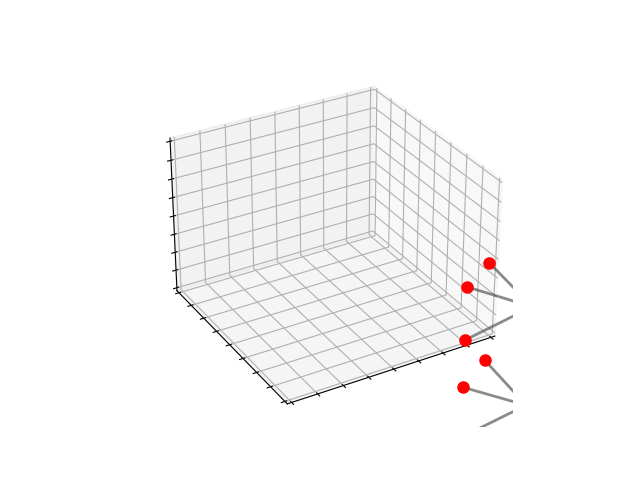

In [62]:
# cell_params, names, coords_frac =  readCIF('MOCJEU_clean.cif')
# names, coords, bond = readMOL('MOCJEU_clean.mol')
# names, coords, bond = readMOL('convert_out (10).mol')

mol_str = 'XOMCIL'
names, coords, bond = readMOL2('dataset_mol2/'+mol_str+'.mol2')


list_rmv = META_DATA[mol_str]['Remove']
names, coords, bond = remove(list_rmv, names, coords, bond)


N = len(coords)
bond_full = np.zeros((N,N))
for i in range(N):
    for j in bond[np.where(bond[:,0]==i),1][0]:
        bond_full[i,j] = 1
        bond_full[j,i] = 1

Plot(coords/2, bond, names)

In [63]:
N = len(coords)

bond_full = np.zeros((N,N))
for i in range(N):
    for j in bond[np.where(bond[:,0]==i),1][0]:
        bond_full[i,j] = 1
        bond_full[j,i] = 1

for i in np.where(np.array(names)=='O')[0]:
    S = 0
    for j in np.where(bond_full[i]==1)[0]:
        if names[j]=='H':
            S += 1
    if S==2:
        print('O '+str(i)+' '+str(np.sum(bond_full[i,:])))
        for j in np.where(bond_full[i]==1)[0]:
            if names[j]=='H':
                print(' H '+str(j))
    if S==1:
        print('O '+str(i)+' '+str(np.sum(bond_full[i,:])))
        for j in np.where(bond_full[i]==1)[0]:
            if names[j]=='H':
                print(' H '+str(j))
print()
for i in np.where(np.array(names)=='O')[0]:
    if sum(bond_full[i,:])!=1:
        print('O '+str(i))

print()
print('>5')
for i in range(N):
    if np.sum(bond_full[i,:])>5:
        print(names[i]+' '+str(i))
        for j in np.where(bond_full[i,:])[0]:
            print(str(int(np.sum(bond_full[j,:])))+'n  '+names[j]+' '+str(j))

print()
print(np.where(bond_full[1,:])[0])

print()
for i in range(N):
    if np.sum(bond_full[i,:])==0:
        print('0:  '+str(i))
    if np.sum(bond_full[i,:])==3:
        print(i)

print()
for i in np.where(np.array(names)=='O')[0]:
    print(i)

print(names)


O 1
O 2
O 6
O 7
O 8
O 10
O 11
O 12
O 14
O 15
O 29

>5
Er 0
3n  O 1
2n  O 2
2n  O 6
3n  O 7
1n  O 9
3n  O 12
3n  O 15
1n  O 18
1n  O 19
Er 16
3n  O 12
3n  O 14
1n  O 17
1n  O 25
1n  O 26
1n  O 27
1n  O 28
2n  O 29
1n  O 30

[ 0  3 20]

1
3
4
5
7
8
12
13
14
15

1
2
6
7
8
9
10
11
12
14
15
17
18
19
25
26
27
28
29
30
['Er', 'O', 'O', 'C', 'C', 'C', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'C', 'O', 'O', 'Er', 'O', 'O', 'O', 'Er', 'Er', 'Er', 'Er', 'Er', 'O', 'O', 'O', 'O', 'O', 'O']


In [57]:
def V(coords_flat, C=1e-2, K=1, H=5):
    N = len(coords_flat)//3
    x = coords_flat.reshape((N,3))
    V = 0
    for i in range(N):
        for j in np.concatenate((np.arange(i),np.arange(i+1,N))):
            if not j in bond[np.where(bond[:,0]==i),1][0]:
                V += C/(np.linalg.norm(x[i,:]-x[j,:]))
    
        for j in bond[np.where(bond[:,0]==i),1][0]:
            V += K*1/2*(np.linalg.norm(x[i,:]-x[j,:]) - 1.2)**2
        
        V += H*1/2*(np.dot(n,x[i,:]))**2
    return V

def F(coords_flat, C=1e-2, K=1, H=5):
    N = len(coords_flat)//3
    x = coords_flat.reshape((N,3))
    F = np.zeros((N,3))
    for i in range(N):
        for j in np.concatenate((np.arange(i),np.arange(i+1,N))):
            if not j in bond[np.where(bond[:,0]==i),1][0]:
                F[i,:] = C/(np.linalg.norm(x[i,:]-x[j,:]))**2*(x[j,:]-x[i,:])/np.linalg.norm(x[i,:]-x[j,:])
    
        for j in bond[np.where(bond[:,0]==i),1][0]:
            F[i,:] += -K*(np.linalg.norm(x[i,:]-x[j,:]) - 1.2) * (x[i,:]-x[j,:])/np.linalg.norm(x[i,:]-x[j,:])

        F[i,:] += -H*(np.dot(n,x[i,:]))*n

    return -F.reshape(-1)


  message: Desired error not necessarily achieved due to precision loss.
  success: False
   status: 2
      fun: 124.76884334878672
        x: [ 4.777e+00  9.153e+00 ...  8.181e+00  1.080e+00]
      nit: 8
      jac: [-8.855e-01  5.364e-01 ...  6.160e-02  1.140e-01]
 hess_inv: [[ 9.764e-01  1.381e-02 ...  4.149e-02  4.679e-03]
            [ 1.381e-02  9.920e-01 ... -2.478e-02 -2.772e-03]
            ...
            [ 4.149e-02 -2.478e-02 ...  9.093e-01 -2.529e-02]
            [ 4.679e-03 -2.772e-03 ... -2.529e-02  9.928e-01]]
     nfev: 55
     njev: 44


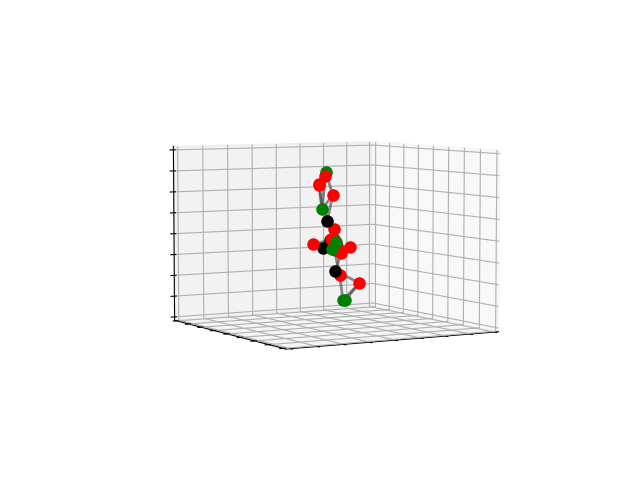

No such comm: 0eecb1bb7f8a45bdafb7ceed52af0343


In [58]:
C = 0.5
K = 1
H = 5

n = plane(coords)
res = minimize(lambda x: V(x,C=C,K=K,H=H), x0 = coords.reshape((3*N)), jac=lambda x:F(x,C=C,K=K,H=H), method='BFGS')
print(res)
coords_ = res.x.reshape((-1,3))/2
Plot(coords_-np.mean(coords_, axis=0), bond, names, view=[5,60])

In [59]:
def V2(coords_flat, C=1e-2, H=5, D=5):
    x = coords_flat.reshape((N,3))
    V = 0
    for i in range(N):
        for j in range(N):
            if j!=i:
                V += C/np.linalg.norm(x[i,:]-x[j,:])
                if j in np.where(bond_full[i,:])[0]:#bond[np.where(bond[:,0]==i),1][0]:
                    V += 1/2*D*int(np.linalg.norm(x[i,:]-x[j,:]) > d*0.9)*(np.linalg.norm(x[i,:]-x[j,:])-d*0.9)**2 #D*max(0, np.linalg.norm(x[i,:]-x[j,:]) - d)
                else:
                    V += 1/2*D*int(np.linalg.norm(x[i,:]-x[j,:]) < d*1.1)*(np.linalg.norm(x[i,:]-x[j,:])-d*1.1)**2 #D*max(0, d - np.linalg.norm(x[i,:]-x[j,:]))
    
        V += H*1/2*(np.dot(n,x[i,:]))**2
    return V

def F2(coords_flat, C=1e-2, H=5, D=5):
    x = coords_flat.reshape((N,3))
    F = np.zeros((N,3))
    for i in range(N):
        for j in range(N):
            if j!=i:
                F[i,:] += -C/np.linalg.norm(x[i,:]-x[j,:])**3*(x[j,:]-x[i,:])
                if j in np.where(bond_full[i,:])[0]:#bond[np.where(bond[:,0]==i),1][0]:
                    F[i,:] += D*int(np.linalg.norm(x[i,:]-x[j,:]) > d*0.9) * (x[j,:]-x[i,:])/np.linalg.norm(x[i,:]-x[j,:])*(np.linalg.norm(x[i,:]-x[j,:])-d*0.9)
                else:
                    F[i,:] += -D*int(np.linalg.norm(x[i,:]-x[j,:]) < d*1.1) * (x[j,:]-x[i,:])/np.linalg.norm(x[i,:]-x[j,:])*(d*1.1-np.linalg.norm(x[i,:]-x[j,:]))
        F[i,:] += -H*(np.dot(n,x[i,:]))*n
    return -F.reshape(-1)

d = np.mean([np.linalg.norm(np.array([coords_[bond[i,0],j]-coords_[bond[i,1],j] for j in range(3)])) for i in range(len(bond)) ])
print(d)


0.5557398953459634


  message: Desired error not necessarily achieved due to precision loss.
  success: False
   status: 2
      fun: 12.554344975260959
        x: [ 2.463e+00  4.440e+00 ...  3.792e+00  1.780e-01]
      nit: 77
      jac: [ 2.232e-02  2.089e-01 ... -6.715e-01 -6.599e-02]
 hess_inv: [[ 2.401e-02  1.668e-02 ...  1.337e-02 -1.438e-03]
            [ 1.668e-02  4.631e-02 ...  2.544e-02 -3.327e-03]
            ...
            [ 1.337e-02  2.544e-02 ...  6.373e-02  1.314e-03]
            [-1.438e-03 -3.327e-03 ...  1.314e-03  7.989e-02]]
     nfev: 159
     njev: 148


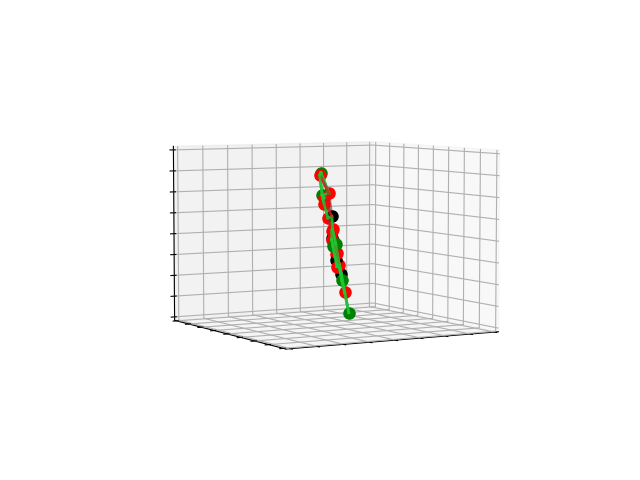

In [60]:
C = 1e-2
H = 50
D = 100
res = minimize(lambda x: V2(x,C=C,H=H,D=D), x0 = coords_.reshape((3*N)), method='BFGS', jac=lambda x: F2(x,C=C,H=H,D=D))
print(res)
coords__ = res.x.reshape((-1,3))
Plot(coords__-np.mean(coords__, axis=0), bond, names, view=[5,60], radius=d*1.01)

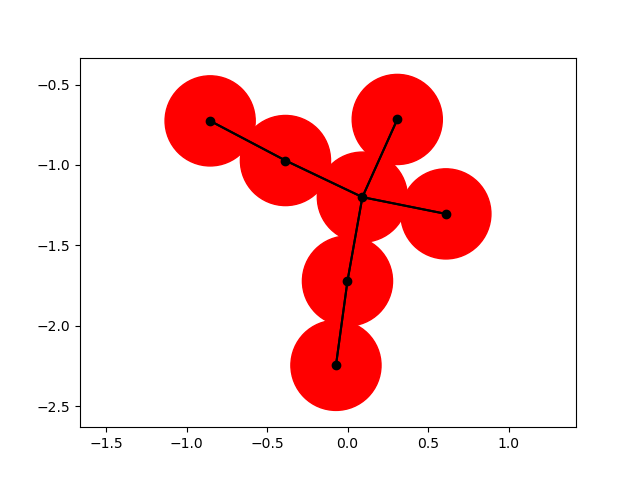

0.2645575191248278


No such comm: 9949525289b94c8fb0e32ee158d09577


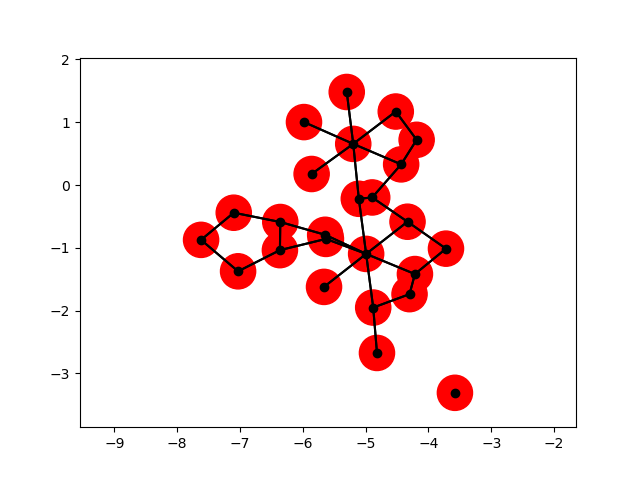

0.3552706670257489


In [35]:
a = np.array([n[1], -n[0], 0])/np.sqrt(1-n[2]**2)
b = np.array([n[0]*n[2], n[1]*n[2], n[2]**2-1])/np.sqrt(1-n[2]**2)

plane_coords = np.zeros((N,2))
for i in range(N):
    plane_coords[i,:] = np.array([-np.dot(a,coords__[i,:]),-np.dot(b,coords__[i,:])])

fig, ax = plt.subplots()
ax.plot(plane_coords[:,0], plane_coords[:,1],'ko')
for i in range(N):
    ax.add_patch(plt.Circle(plane_coords[i,:], 0.28, color='r'))
    for j in np.where(bond_full[i,:])[0]:
        plt.plot(np.array([plane_coords[i,0],plane_coords[j,0]]), np.array([plane_coords[i,1],plane_coords[j,1]]), 'k-')
plt.axis('equal')
plt.show()

l = []
for i in range(N):
    for j in np.where(bond_full[i,:])[0]:
        l.append(np.linalg.norm(plane_coords[i,:] - plane_coords[j,:]))
print(np.mean(np.array(l))/2)

### Save planar coordinates

In [22]:
with open('dataset_txt/'+mol_str+'_txt', 'w') as file:
    file.write(str(META_DATA[mol_str]['Distance'])+" \n")
    for i in range(N):
        file.write(str(plane_coords[i,0])+' '+str(plane_coords[i,1])+'\n')


In [23]:
with open('dataset_txt/'+mol_str+'_txt') as file:
    lines = file.readlines()

d_bis = float(lines[0])
plane_coords_bis = np.array([lines[i].split() for i in range(1,N+1)], float)

print(d_bis)
print(np.sum(plane_coords_bis-plane_coords))

0.28
0.0


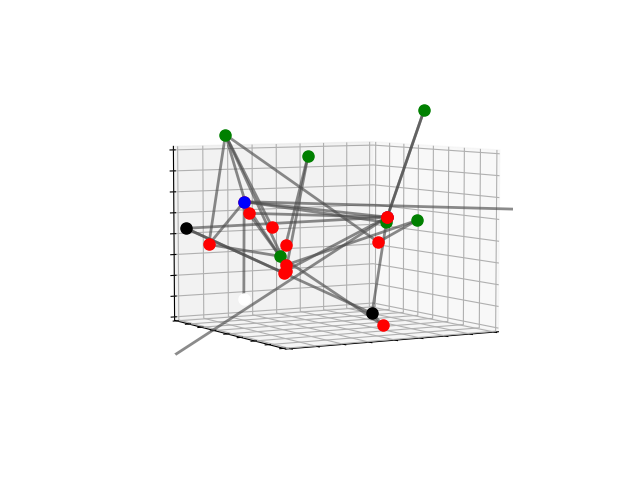

In [10]:
N = len(coords)
d = np.mean([np.linalg.norm(np.array([coords[bond[i,0],j]-coords[bond[i,1],j] for j in range(3)])) for i in range(len(bond)) ])
n = plane(coords)

def V_1(coords_flat, K=1, H=5, C=1e-2):
    x = coords_flat.reshape((N,3))
    V = 0
    for i in range(N):
        for j in range(N):
            if j!=i:
                if j in bond[np.where(bond[:,0]==i),1][0]:
                    V += 1/2*K*(np.linalg.norm(x[i,:]-x[j,:])-0.1)**2
                else:
                    V += -C/(np.linalg.norm(x[i,:]-x[j,:]))
        V += H*1/2*(np.dot(n,x[i,:]))**2
    return V

def F_1(coords_flat, K=1, H=5, C=1e-2):
    x = coords_flat.reshape((N,3))
    F = np.zeros((N,3))
    for i in range(N):
        for j in range(N):
            if j!=i:
                if j in bond[np.where(bond[:,0]==i),1][0]:
                    F[i,:] += -K*(np.linalg.norm(x[i,:]-x[j,:])-0.1) * (x[i,:]-x[j,:])/np.linalg.norm(x[i,:]-x[j,:])
                else:
                    F[i,:] += -C/(np.linalg.norm(x[i,:]-x[j,:]))**3*(x[i,:]-x[j,:])
        F[i,:] += -H*(np.dot(n,x[i,:]))*n
    return -F.reshape(-1)

res = minimize(lambda x: V_1(x, K=10, C=1, H=0), x0 = coords.reshape((3*N)),jac=lambda x: F_1(x, K=10, C=1, H=0) , method='BFGS')
coords_1 = res.x.reshape((-1,3))/2
Plot(coords_1-np.mean(coords_1, axis=0), bond, names, view=[5,60])

In [7]:
print(d/2)
np.mean([np.linalg.norm(np.array([coords_1[bond[i,0],j]-coords_1[bond[i,1],j] for j in range(3)])) for i in range(len(bond)) ])

0.9382710315480398


2.316084646928366

In [13]:
from IPython.display import display, clear_output
M = 1000
X = np.zeros((M,N,3))
X[0,:,:] = coords_
dt = 0.1
for i in range(M-1):
    clear_output(wait=True)
    display('Iteration '+str(i))
    X[i+1,:,:] = X[i,:,:] - dt*F2(X[i,:,:].reshape(-1)).reshape(N,3)

'Iteration 998'

Animation size has reached 21137386 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


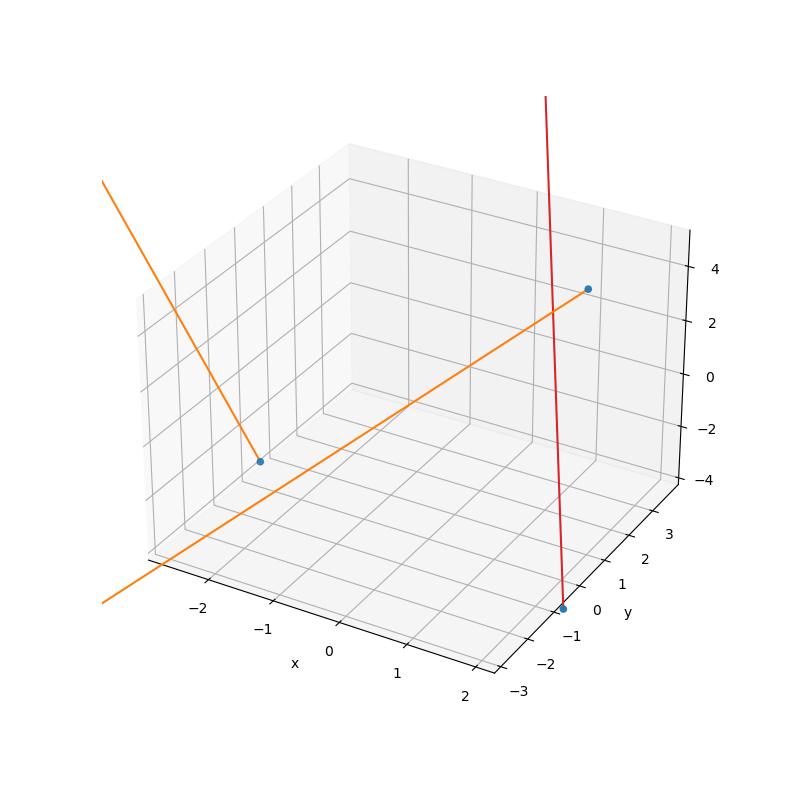

ERROR:tornado.application:Exception in callback <bound method TimerBase._on_timer of <matplotlib.backends.backend_webagg_core.TimerTornado object at 0x7fbc143e42b0>>
Traceback (most recent call last):
  File "/home/hjaunin/miniconda3/envs/venvPulser/lib/python3.10/site-packages/tornado/ioloop.py", line 919, in _run
    val = self.callback()
  File "/home/hjaunin/miniconda3/envs/venvPulser/lib/python3.10/site-packages/matplotlib/backend_bases.py", line 1216, in _on_timer
    ret = func(*args, **kwargs)
  File "/home/hjaunin/miniconda3/envs/venvPulser/lib/python3.10/site-packages/matplotlib/animation.py", line 1477, in _step
    still_going = super()._step(*args)
  File "/home/hjaunin/miniconda3/envs/venvPulser/lib/python3.10/site-packages/matplotlib/animation.py", line 1189, in _step
    self._draw_next_frame(framedata, self._blit)
  File "/home/hjaunin/miniconda3/envs/venvPulser/lib/python3.10/site-packages/matplotlib/animation.py", line 1208, in _draw_next_frame
    self._draw_frame(f

In [16]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(projection='3d')
l = ax.scatter(X[0,:,0],X[0,:,1],X[0,:,2],'k.')

lb = []
for i in range(N):
    for j in bond[np.where(bond[:,0]==i),1][0]:
        ltemp, = ax.plot(np.array([X[0,i,0],X[0,j,0]])\
                            ,np.array([X[0,i,1],X[0,j,1]])\
                            ,np.array([X[0,i,2],X[0,j,2]])\
                            )
        lb.append(ltemp)
        
ax.set_ylabel('y')
ax.set_xlabel('x')


def animate(i):
    ind = i
    
    l._offsets3d = (X[ind,:,0],X[ind,:,1],X[ind,:,2])
    
    k = 0
    for m in range(N):
        for j in bond[np.where(bond[:,0]==m),1][0]: 
            lb[k].set_data(np.array([X[ind,m,0],X[ind,j,0]])\
                            ,np.array([X[ind,m,1],X[ind,j,1]]))
            lb[k].set_3d_properties(np.array([X[ind,m,2],X[ind,j,2]]))
            k += 1

ani = matplotlib.animation.FuncAnimation(fig, animate, interval=25, frames=M)

       
HTML(ani.to_jshtml())

In [5]:
cif2xyz('MOCJEU_clean.cif', 'MOCJEU_clean2.xyz')

In [10]:
dt = 0.02
M = 20000
ratio = 100

X = np.zeros((M//ratio,len(coords),3))
X[0,:,:] = coords.copy()
# V = np.zeros((len(coords),3))
for i in range(1,M//ratio):
    x = X[i-1,:,:]
    for m in range(ratio):
        k1 = F(x)
        k2 = F(x+dt/2*k1)
        k3 = F(x+dt/2*k2)
        k4 = F(x+dt*k3)
        x = x + dt/6*(k1+2*k2+2*k3+k4)
        # x += dt*F(x)
    X[i,:,:] = x

KeyboardInterrupt: 

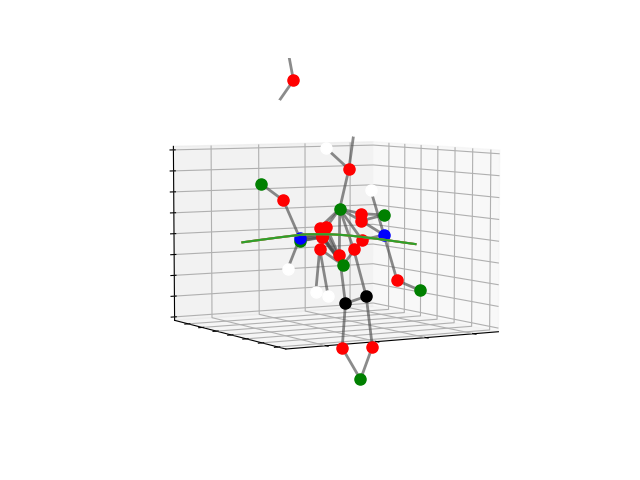

In [25]:
x = np.linspace(0.1,5,100)
d = 1.5
plt.plot(x, 1/x+np.maximum(0,x-d))
plt.show()
                